# Car Detection and Recognition

Project for Hacklytics 2021 by Kunal Aneja
Contact:
kunal.aneja101@gmail.com
770-570-7670

# Import

In [1]:
#Importing libaries that are neccasary for basic processing
import os 
import cv2
import io
import numpy as np
import pandas as pd
#Importing for GCP vision API
from google.cloud import vision
from google.oauth2 import service_account
#Importing for Video-to-Img Processing
from PIL import Image
from matplotlib import cm
#Importing for area location for lisence plate in frame
from shapely.geometry import Polygon
#Importing for logo drawing
from PIL import ImageDraw, ImageFont
#Importing Selenium for getting car color
from selenium import webdriver
from selenium.webdriver.common.keys import Keys
import time
from webdriver_manager.chrome import ChromeDriverManager
#Importing for lisence plate
import imutils
import matplotlib.pyplot as plt
%matplotlib inline
import skimage
import skimage.io
from skimage import filters
from skimage.filters import threshold_mean, threshold_otsu
from skimage import feature, filters
from scipy.ndimage import distance_transform_edt, distance_transform_cdt # euclidian distance - distance to closest background pixel
from scipy.ndimage.morphology import black_tophat

# Preprocessing

## All Possible Cars that can be processed
### Logos

There are some cars that there isn't enough data for so they can't be detected. The following is all the possible Cars Logos that can be detected --> **40**

|1|2|3|4|5|6|7|8|9|10|
|-|-|-|-|-|-|-|-|-|-|
|Dodge|Maserati|Audi|Saab|Ferrari|Mazda|Ford|Kia|Volkswagen|Jaguar|
|Mitsubishi|Jeep|Fiat|Rover|Mercedes|Citroen|Volvo|Hyundai|Seat|Porsche|
|Toyota|Lancia|Dacia|Skoda|Tata|BMW|Alfa Romeo|Suzuki|Subaru|Chevrolet|
|Honda|Daewoo|Lexus|Tesla|Peugeot|Lada|Renault|Nissan|Land Rover|Opel|

### Lisence Plate

All ASCII characters can be processed which is **A-Z** and **1-9** and special characters like but not limited to **!@#%&()?**

### Colors

All colors can be detected using RGB and Hex. *When generating color names the RGB is converted to Hex then to English names so some of the names might not be as familar than others*

# Get the data
As of right now the video file is stored locally on my harddrive but if deploying the file managment will definelty change

The code design is to take each **full second frame** as that is the most accurate but also most fastest frame count. 

In [2]:
def extract_image_one_fps(video_source_path):
    vidcap = cv2.VideoCapture(video_source_path)
    count = 0
    success = True
    while success:
        vidcap.set(cv2.CAP_PROP_POS_MSEC,(count*1000)) # 2 second***   
        success,image = vidcap.read()
        ## Stop when last frame is identified
        image_last = cv2.imread("frame{}.png".format(count-1))
        if np.array_equal(image, image_last):
            break
        try:
            cv2.imwrite("frame%d.png" % count, image)     # save frame as PNG file
            print( '{}.sec reading a new frame:{}'.format(count,success))
            count += 1
        except Exception as error:
            print("Finished")

In [3]:
DataDIRECTORY = "/Users/kunal/Documents/AAPersonalAIPROJECT/Cardetection/PersonalData/"

In [4]:
os.chdir(DataDIRECTORY)
extract_image_one_fps("/Users/kunal/Documents/AAPersonalAIPROJECT/Cardetection/PersonalData/testvid.mp4")

0.sec reading a new frame:True
1.sec reading a new frame:True
2.sec reading a new frame:True
3.sec reading a new frame:True
4.sec reading a new frame:True
5.sec reading a new frame:True
6.sec reading a new frame:True
7.sec reading a new frame:True
8.sec reading a new frame:True
9.sec reading a new frame:True
10.sec reading a new frame:True
11.sec reading a new frame:True
12.sec reading a new frame:True
13.sec reading a new frame:True
14.sec reading a new frame:True
15.sec reading a new frame:True
16.sec reading a new frame:True
Finished


## Show a random frame

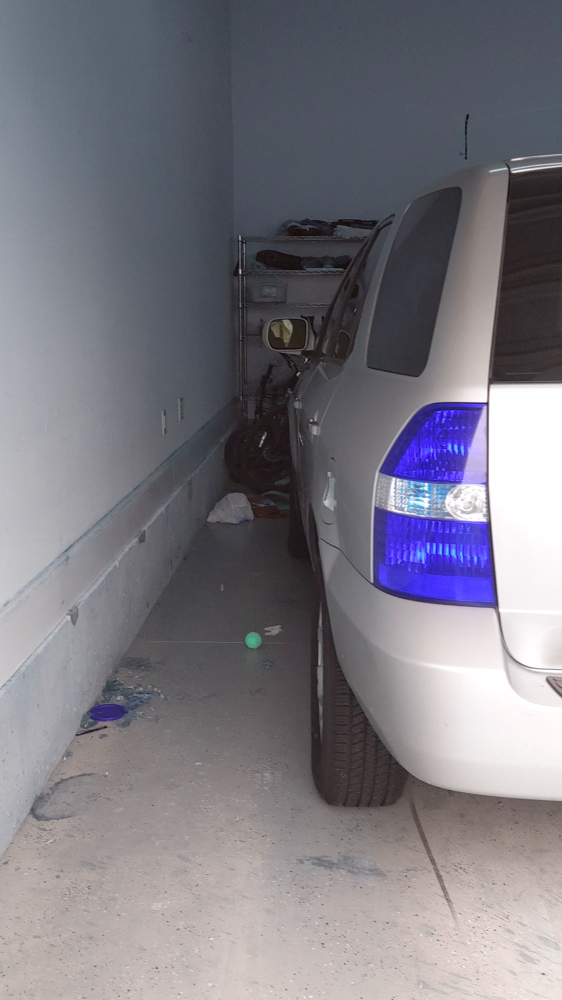

In [5]:
TestingIMG = cv2.imread("frame3.png")
IMAGETEST = Image.fromarray(TestingIMG)
IMAGETEST

# Running 1 Specific Video

In [6]:
for i in os.listdir("."):
    if i.endswith(".png"):
        print(i)

frame0.png
frame1.png
frame10.png
frame11.png
frame12.png
frame13.png
frame14.png
frame15.png
frame16.png
frame17.png
frame2.png
frame3.png
frame4.png
frame5.png
frame6.png
frame7.png
frame8.png
frame9.png


# Running Multiple Videos

# GCP Key

In order to use the **Google Cloud Platform Vision API**, you need to activate the API on the GCP console and using the Key through the service account it will run. The Vision API does cost money but I am using the free trial right now. 

Please contact Kunal Aneja for access to the key file

In [9]:
path = '/Users/kunal/Documents/AAPersonalAIPROJECT/Cardetection/RunningFINAL/testvid/frame3.png'

In [10]:
key = '/Users/kunal/Documents/AAPersonalAIPROJECT/Cardetection/GOOGLEAPI/key.json'
credentials = service_account.Credentials.from_service_account_file(key)
client = vision.ImageAnnotatorClient(credentials=credentials)
# [START vision_python_migration_text_detection]
with io.open(path, 'rb') as image_file:
    content = image_file.read()

# Image Information

In [11]:
img = cv2.imread(path)
w, h, dis = img.shape 
# Size Data about specifc frame
areaTotal = w*h
print("Width: {}\tHeight: {}\tTotal Area: {}".format(w,h,areaTotal))

Width: 2160	Height: 3840	Total Area: 8294400


In [12]:
def PolygonArea(corners):
    #This formula is used to calculate the area in between a polygon. 
    n = len(corners) # of corners
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += corners[i][0] * corners[j][1]
        area -= corners[j][0] * corners[i][1]
    area = abs(area) / 2.0
    return area

# Objects found in image

This is using https://storage.googleapis.com/openimages/web/index.html dataset.

In [13]:
image = vision.Image(content=content)
response = client.label_detection(image=image)
if response.error.message:
    print(response.error.message)
    print("NOTHINGDETECTED")
texts = response.label_annotations
result = []
for text in texts:
    result.append(text.description)
print("Detected")
for i in result:
    print("\t{}".format(i))

Detected
	Automotive parking light
	Car
	Automotive tail & brake light
	Land vehicle
	Vehicle
	Automotive lighting
	Vehicle registration plate
	Automotive tire
	Motor vehicle
	Automotive design


# Logo

Using GCP logo_detection in Vision API, it detects all logos in the picture. It then futhers gives an accuracy score and if it is greater than **80%** then it is accurate enough to return the value

In [14]:
def findArea(bounds):
    matrix = ((bounds.vertices[0].x, bounds.vertices[0].y),
              (bounds.vertices[1].x, bounds.vertices[1].y),
              (bounds.vertices[2].x, bounds.vertices[2].y),
              (bounds.vertices[3].x, bounds.vertices[3].y))
    polygon = Polygon(matrix)
    return polygon.area

In [15]:
def findMatrix(vert):
    matrix = ((vert.vertices[0].x, vert.vertices[0].y),
              (vert.vertices[1].x, vert.vertices[1].y),
              (vert.vertices[2].x, vert.vertices[2].y),
              (vert.vertices[3].x, vert.vertices[3].y))
    return matrix

In [18]:
def findLOGO(path):
    with io.open(path, 'rb') as image_file:
        content = image_file.read()
    image = vision.Image(content=content)
    response = client.logo_detection(image=image)
    logos = response.logo_annotations
    print('Logos:')
    #for logo in logos:
        #print(logo.description)
    if response.error.message:
        print("Error")
        return([0])
    if not logos:
        print("No logo detected")
        return([0])
    ALLLOGOS = []
    for logo in logos:
        print(logo.description)
        print(logo.score)
        print(findArea(logo.bounding_poly))
        matrix = findMatrix(logo.bounding_poly)
        print(matrix)
        #Check if score is high enough to add to list
        if logo.score > 0.8:
            ALLLOGOS.append(logo.description)
        #Creating image with logo Highlighted
        TINT_COLOR = (0,0,0)
        TRANSPARENCY = 0.25
        OPACITY = int(255 * TRANSPARENCY)
        img = Image.open(path)
        img = img.convert("RGBA")
        overlay = Image.new('RGBA', img.size, TINT_COLOR+(0,))
        draw = ImageDraw.Draw(overlay)  # Create a context for drawing things on it.
        TINT_COLOR = (0,255,0)
        draw.polygon(matrix, fill=TINT_COLOR+(OPACITY,))
        img = Image.alpha_composite(img, overlay)
        img = img.convert("RGB") # Remove alpha for saving in jpg format.
        img
    return ALLLOGOS

# Color 

Using 

In [19]:
def clearEndofTxt(txt):
    if txt.endswith("approx."):
        return txt[:-7]
    elif txt.endswith("solid"):
        return txt[:-5]

In [20]:
def colorCar(path):
    with io.open(path, 'rb') as image_file:
        content = image_file.read()

    image = vision.Image(content=content)

    response = client.image_properties(image=image)
    props = response.image_properties_annotation
    #Iniate the driver for selenium
    driver = webdriver.Chrome(ChromeDriverManager().install())
    
    color_list = []
    for color in props.dominant_colors.colors:
        #print('fraction: {}'.format(color.pixel_fraction))
        #print('\t({},{},{})'.format(color.color.red, color.color.green, color.color.blue))
        #print('\ta: {}'.format(color.color.alpha))
        color_list.append([color.pixel_fraction*100, (int(color.color.red), int(color.color.green), int(color.color.blue)), 
                          '#%02x%02x%02x' % (int(color.color.red), int(color.color.green), int(color.color.blue))])
    total_proportion = sum(i[0] for i in color_list)
    color_list.append([100-total_proportion, (0,0,0), '#%02x%02x%02x' % (0,0,0)])
    for i in color_list:
        link = "https://chir.ag/projects/name-that-color/" + i[2]
        driver.get(link)
        inputTXT = driver.find_element_by_xpath("/html/body/div/div[3]/div[2]/div[2]/div[3]/input")
        inputTXT.send_keys(Keys.CONTROL, 'a')
        inputTXT.send_keys(i[2])
        time.sleep(1)
        color = driver.find_element_by_xpath("/html/body/div/div[3]/div[2]/div[2]/h2")   
        time.sleep(1)
        i.append(clearEndofTxt(color.text))
    driver.close()
    color_list = sorted(color_list,key=lambda l:l[0], reverse=True)
    df = pd.DataFrame(color_list, columns = ['Proportion', 'RGB Color', 'Hex', 'Color Name']) 
    print(df)
    return color_list

In [21]:
colorCar(path)

[WDM] - Current google-chrome version is 88.0.4324
[WDM] - Get LATEST driver version for 88.0.4324
[WDM] - Driver [C:\Users\kunal\.wdm\drivers\chromedriver\win32\88.0.4324.96\chromedriver.exe] found in cache


 
    Proportion        RGB Color      Hex     Color Name
0    30.166668     (79, 79, 84)  #4f4f54          Abbey
1    18.626985        (0, 0, 0)  #000000          Black
2    17.285714  (112, 112, 119)  #707077          Jumbo
3    16.650793     (62, 61, 65)  #3e3d41      Ship Gray
4     5.563492  (233, 233, 239)  #e9e9ef    Athens Gray
5     5.468254  (199, 200, 208)  #c7c8d0          Ghost
6     3.452381  (156, 157, 165)  #9c9da5    Santas Gray
7     1.746032  (105, 109, 127)  #696d7f     Storm Gray
8     0.365079  (234, 112, 123)  #ea707b         Sunglo
9     0.341270   (187, 99, 101)  #bb6365       Contessa
10    0.333333  (211, 120, 119)  #d37877  New York Pink


[[30.166667699813843, (79, 79, 84), '#4f4f54', 'Abbey'],
 [18.626984558068216, (0, 0, 0), '#000000', 'Black'],
 [17.28571355342865, (112, 112, 119), '#707077', 'Jumbo'],
 [16.650792956352234, (62, 61, 65), '#3e3d41', 'Ship Gray'],
 [5.563491955399513, (233, 233, 239), '#e9e9ef', 'Athens Gray'],
 [5.468253791332245, (199, 200, 208), '#c7c8d0', 'Ghost'],
 [3.452381119132042, (156, 157, 165), '#9c9da5', 'Santas Gray'],
 [1.746031828224659, (105, 109, 127), '#696d7f', 'Storm Gray'],
 [0.36507935728877783, (234, 112, 123), '#ea707b', 'Sunglo'],
 [0.3412698395550251, (187, 99, 101), '#bb6365', 'Contessa'],
 [0.33333334140479565, (211, 120, 119), '#d37877', 'New York Pink']]

# Lisence Plate

In [22]:
img = Image.open(path)

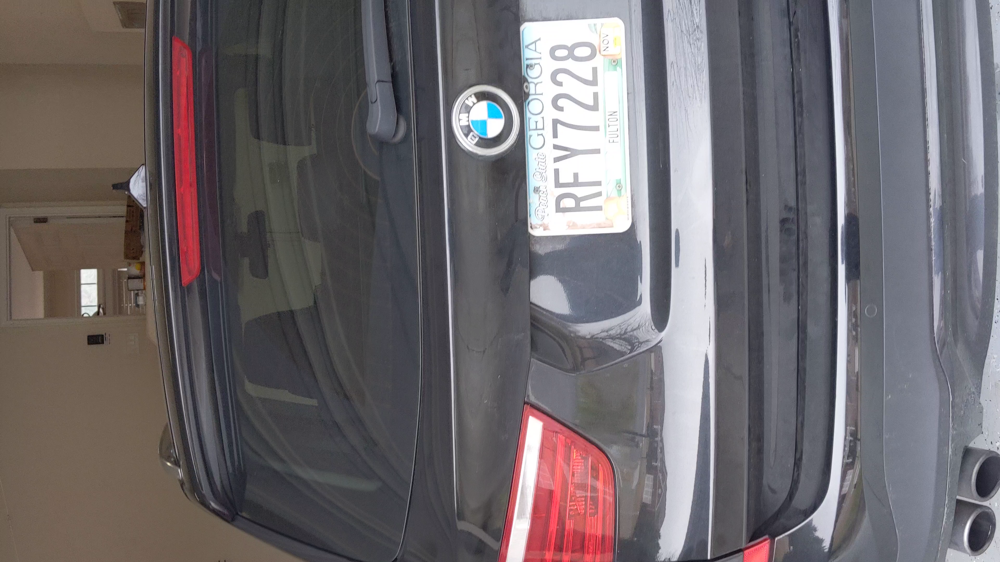

In [23]:
img

In [24]:
img = cv2.imread(path)
img = cv2.resize(img, (620,480))
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) #convert to grey scale

In [25]:
gray = cv2.bilateralFilter(gray, 13, 15, 15)

In [26]:
edged = cv2.Canny(gray, 30, 200) #Perform Edge detection

In [27]:
contours=cv2.findContours(edged.copy(),cv2.RETR_TREE,
                                            cv2.CHAIN_APPROX_SIMPLE)
contours = imutils.grab_contours(contours)
contours = sorted(contours,key=cv2.contourArea, reverse = True)[:10]
screenCnt = None

In [28]:
for c in contours:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.018 * peri, True)
    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        screenCnt = approx
        break

In [29]:
screenCnt

array([[[383,  15]],

       [[322,  23]],

       [[331, 201]],

       [[391, 191]]], dtype=int32)

In [30]:
matrix = ((int((screenCnt[0][0][0]/620)*3840), int((screenCnt[0][0][1]/480)*2160)), 
          (int((screenCnt[1][0][0]/620)*3840), int((screenCnt[1][0][1]/480)*2160)),
          (int((screenCnt[2][0][0]/620)*3840), int((screenCnt[2][0][1]/480)*2160)),
          (int((screenCnt[3][0][0]/620)*3840), int((screenCnt[3][0][1]/480)*2160)))
print(matrix)

((2372, 67), (1994, 103), (2050, 904), (2421, 859))


In [31]:
# Masking the part other than the number plate
mask = np.zeros(gray.shape,np.uint8)
new_image = cv2.drawContours(mask,[screenCnt],0,255,-1,)
new_image = cv2.bitwise_and(img,img,mask=mask)

In [32]:
TINT_COLOR = (0,0,0)
#colors = [(0,255,0), (0,0,255), (255,0,0)]
TRANSPARENCY = 0.25
OPACITY = int(255 * TRANSPARENCY)
img = Image.open(path)
img = img.convert("RGBA")
overlay = Image.new('RGBA', img.size, TINT_COLOR+(0,))
draw = ImageDraw.Draw(overlay)  # Create a context for drawing things on it.

In [33]:
TINT_COLOR = (0,255,0)
draw.polygon(matrix, fill=TINT_COLOR+(OPACITY,))

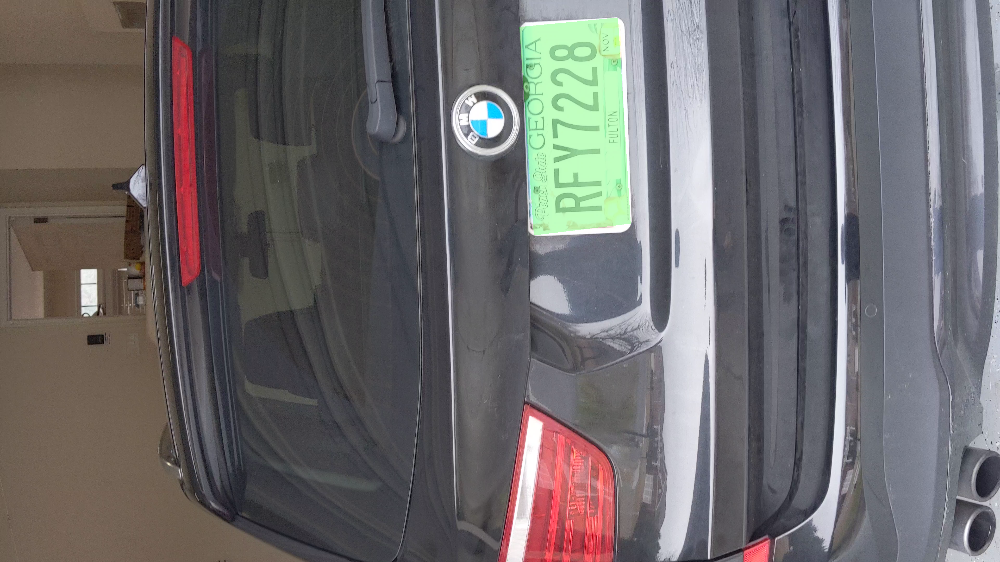

In [34]:
img = Image.alpha_composite(img, overlay)
img = img.convert("RGB") # Remove alpha for saving in jpg format.
img

# Lisence Plate Image Editing

In [35]:
img = "/Users/kunal/Documents/AAPersonalAIPROJECT/Cardetection/RecognizeLisencePlate/demo/plates/GEORGIA.jpg"

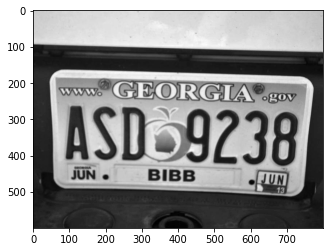

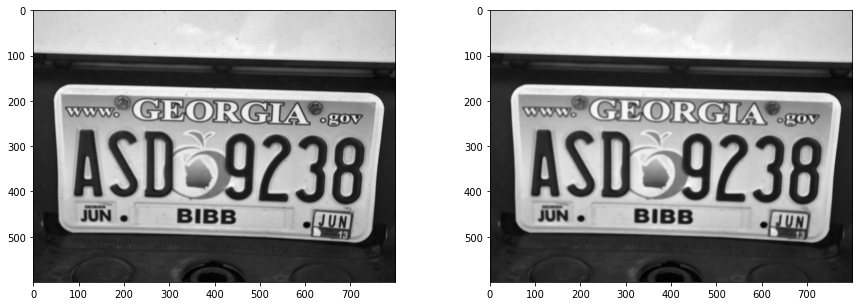

In [36]:
plate = skimage.io.imread(img, as_gray=True)
plt.imshow(plate, cmap='gray')
plate_denoised = filters.median(plate, selem=np.ones((5,5)))
f, (ax0, ax1) = plt.subplots(1,2, figsize=(15,5))
ax0.imshow(plate, cmap='gray')
ax1.imshow(plate_denoised, cmap='gray')

In [37]:
fig, ax = try_all_threshold(plate_denoised, figsize=(10, 8), verbose=True)
plt.show()
plt.savefig("test.png")

NameError: name 'try_all_threshold' is not defined

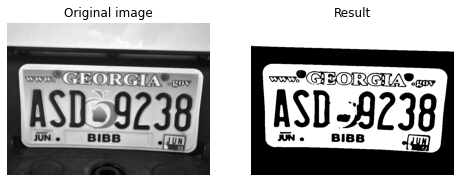

In [39]:
thresh = threshold_mean(plate_denoised)
binary = plate_denoised > thresh

otsu = threshold_otsu(plate_denoised)
fig, axes = plt.subplots(ncols=2, figsize=(8, 3))
ax = axes.ravel()

ax[0].imshow(plate_denoised, cmap=plt.cm.gray)
ax[0].set_title('Original image')

ax[1].imshow(binary, cmap=plt.cm.gray)
ax[1].set_title('Result')

for a in ax:
    a.axis('off')

plt.show()

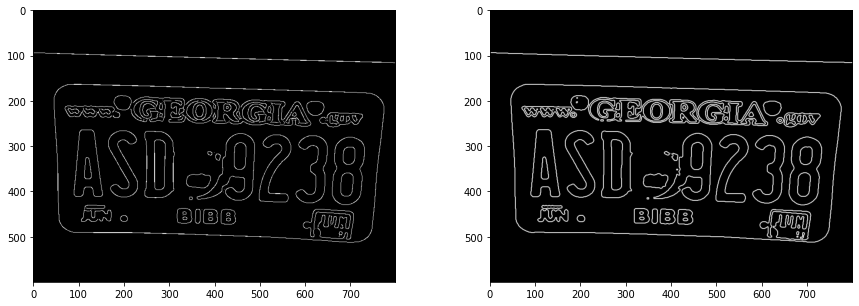

In [40]:
edges = skimage.feature.canny(binary, sigma=3)
sobel_edges = skimage.filters.sobel(binary)

f, (ax0, ax1) = plt.subplots(1,2, figsize=(15,5))
ax0.imshow(edges, cmap='gray')
ax1.imshow(sobel_edges, cmap='gray')

Text(0.5, 1.0, 'Euclidian distance')

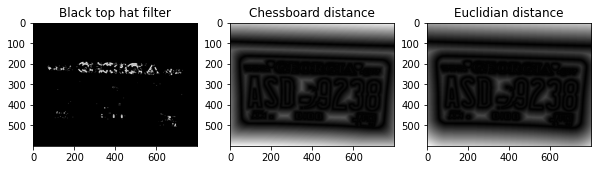

In [41]:
# euclidian distance, chessboard distance and city block (manhattan) distance
euclidian = distance_transform_edt(~edges)
dt = distance_transform_cdt(~edges, metric='chessboard')     # call on negative of edges
blackTopHat = black_tophat(edges, size=(5,5))               # black top hat filter         

fig, ax = plt.subplots(ncols=3, figsize=(10, 5))

ax[0].imshow(blackTopHat, cmap='gray')
ax[0].set_title('Black top hat filter')
ax[1].imshow(dt, cmap='gray')
ax[1].set_title('Chessboard distance')
ax[2].imshow(euclidian, cmap='gray')
ax[2].set_title('Euclidian distance')

In [38]:
peak_idx = feature.peak_local_max(dt, indices=True, min_distance=10)
plt.plot(peak_idx[:,1], peak_idx[:,0], 'r.')
plt.imshow(dt)

NameError: name 'dt' is not defined

# Using OCR

In [ ]:
pip install pytesseract